# Výpočty bez počítání splinu

In [1]:
using DifferentialEquations
using Plots; gr()
using IntervalArithmetic
using LinearAlgebra
using LaTeXStrings
using PrettyTables

## Výpočet bez splinu
Použijeme derivaci vypočtenou z numeriky a pak navážeme jednotlivé polynomy na sebe hladce pomocí hodnoty první derivace v uzlových bodech.\
Zatím asi jen pro horní odhad, ten se dělá jednodušeji a potřebujeme ověřit jestli se algoritmus zjednoduší a zrychlí při minimálně zachování přesnosti.


## Functions

- `plaplace_solve` - Numeric solution of p-laplace
- `polynomial_interpolation` - IA interpolation without spline
- `cubic_natural_spline` - IA interpolation of given points with natural cubic spline
- `get_u1` - Rebuilds interval expression of U₁ˢ by integrating U₂ˢ.
- `der_cubic_spline` - First derivative of interval cubic spline
- `lower_estimate` - Interval lower estimate of first eigenvalue λ₁
- `upper_estimate` - Interval upper estimate of first eigenvalue λ₁

In [24]:
"""
    plaplace_solve(λi, p, n; u₂0=1.0, dom=(0.0, 1.0))

Numericaly solves p-Laplace equation using shooting method.

Arguments:
λᵢₙᵢₜ ... initial interval for λ₁
p    ... p of p-Laplacian
n    ... number of solution points
u₂0  ... initial condition for u₂
dom  ... domain

Return:
t, tᴵ    ... division points where the solution is interpolated,
            double precision value and its interval representation
U₁, U₁ᴵ  ... numerical approximation of u₁ at t, tᴵ
U₂, U₂ᴵ  ... numerical approximation of u₂ at t, tᴵ
Λ₁       ... numerical approximation of first eigenvalue λ₁
"""
function plaplace_solve(λᵢₙᵢₜ, p, n; u₂0=1.0, dom=(0.0, 1.0))
   
    function sl(du,u,P,t)
        λ, p = P
        du[1] = abs(u[2])^(1/(p-1)) * sign(u[2])
        du[2] = -λ * abs(u[1])^(p-1)*sign(u[1]) 
    end
    
    tl, tr = dom
    
    u0 = [0.0; u₂0;] # initial condition
    a, b = λᵢₙᵢₜ
    Λ₁ = (a + b)/2
    Δt = (tr-tl)/(n-1)
    e = 1e-12 # stop condition

    while (b-a) >= e
        prob = ODEProblem(sl, u0, dom, (Λ₁, p))
        sol = solve(prob, saveat=Δt, abstol=1e-8,reltol=1e-8)
        if sol(tr)[1] == 0
            break
        else
            probA = ODEProblem(sl, u0, dom, (a, p))
            solA = solve(probA, saveat=Δt, abstol=1e-8,reltol=1e-8)
            probS = ODEProblem(sl, u0, dom, (Λ₁, p))
            solS = solve(probS, saveat=Δt, abstol=1e-8,reltol=1e-8)
            if solA(tr)[1] * solS(tr)[1] < 0
                b = Λ₁
            else
                a = Λ₁
            end
            Λ₁ = (a+b)/2
        end
    end

    prob = ODEProblem(sl, u0, dom, (Λ₁, p))
    sol = solve(prob, saveat=Δt, abstol=1e-8,reltol=1e-8)

    t = collect(LinRange(0,1,n-1))
    tᴵ = [@interval(i) for i in t]
    U₁ = [u[1] for u in sol(t).u]
    U₁ = U₁ .- minimum(U₁)

    U₁ᴵ = [@interval(u[1]) for u in U₁]
    U₁ᴵ = U₁ᴵ .- inf(minimum(U₁ᴵ))
    
    U₂ = [u[2] for u in sol(t).u]
    U₂ᴵ = [@interval(u[2]) for u in sol(t).u]
    
    # první derivace použitá pro polynomy
    Ud = []
    for u2 in U₂
        if u2 >= 0
           append!(Ud, u2^(1/(p-1))) 
        else
           append!(Ud, -(-u2)^(1/(p-1)))  
        end
    end
    
    Udᴵ = []
    for u2I in U₂ᴵ
        if u2I >= 0
           append!(Udᴵ, u2I^(1/(p-1))) 
        else
           append!(Udᴵ, -(-u2I)^(1/(p-1)))  
        end
    end

    return t, tᴵ, U₁, U₁ᴵ, U₂, U₂ᴵ, Ud, Udᴵ, Λ₁
end;

### Koeficienty kubického polynomu

Symbolický výpočet koeficientů kubického polynomu mezi 2 body. 

$$u(x) = Ax^3 + Bx^2 + Cx + D$$

Neznámé jsou $A, B, C, D$, naopak známe hodnotu $u(x)$ a $u'(x)$ v krajních bodech.  
Chceme tedy řešit následující soustavu:

\begin{align}
Ax_1^3 + Bx_1^2 + Cx_1 + D &= u_1 \\
Ax_2^3 + Bx_2^2 + Cx_2 + D &= u_2 \\
3Ax_1^2 + 2Bx_1 + C &= u_1' \\
3Ax_2^2 + 2Bx_2 + C &= u_2' \\
\end{align}

kde $u_1, u_1'$ jsou hodnoty vlevo a $u_2, u_2'$ hodnoty vpravo, $x_1$ odpovídá t[i] a $x_2$ t[i+1]. Řešením soustavy jsou koeficienty:

$$ A = \frac{- 2 u_{1} + u_1' x_{1} - u_1' x_{2} + 2 u_{2} + u_2' x_{1} - u_2' x_{2}}{\left(x_{1} - x_{2}\right)^{3}} $$


$$ B = \frac{u_2' - u_1' + 3A(x_1^2-x_2^2)}{2(x_2-x_1)} $$

$$ C = u_1'-3Ax_1^2-2Bx_1 $$

$$ D = u_1 -Ax_1^3 - Bx_1^2 - Cx_1 $$



In [3]:
function polynomial_interpolation(t, tᴵ, U₁ᴵ, Udᴵ)#U, Uᴵ, Uₗd2, Uᵣd2; ns=10)

    
    csc_V = Vector[]
 
    
    for i in 1:length(Udᴵ)-1
        a = b = c = d = 0
        a = (2*(U₁ᴵ[i+1]-U₁ᴵ[i]) + (Udᴵ[i]+Udᴵ[i+1])*(t[i]-t[i+1]))/(t[i]-t[i+1])^3
        b = (Udᴵ[i+1] - Udᴵ[i] + 3*a*(t[i]^2-t[i+1]^2))/(2*(t[i+1]-t[i]))
        c = Udᴵ[i] - t[i]*(2*b+t[i]*3*a)
        d = U₁ᴵ[i] - t[i]*(c+t[i]*(b+t[i]*a))
        
        append!(csc_V, [Interval{Float64}[a,b,c,d]])
    end
    
   
    # napočítat boxíky výsledné fce
    #ns = 1 
    V = Interval{Float64}[] 
    for i in 1:length(Udᴵ)-1
        x_int = t[i]..t[i+1]
        #x_int = mince(x_dom,ns)
        f(x) = csc_V[i][4] + x*(csc_V[i][3] + 
            x*(csc_V[i][2] + csc_V[i][1]*x))
        append!(V, f.(x_int))
    end
        
    return csc_V, V
end;

In [9]:
"""
   cubic_natural_spline(t, tᴵ, U, Uᴵ, Uₗd2, Uᵣd2; ns=10)

IA interpolation of given points by natural cubic spline. 
Returns spline coefficients `csc_V` as well as interval values `V` 
of the spline function.

Arguments:
t, tᴵ        ... division points
U, Uᴵ        ... values to be interpolated
Uₗd2, Uᵣd2    ... left and right boundary values of second derivative
ns=10        ... number of division points for each single piece of spline
"""
function cubic_natural_spline(t, tᴵ, U, Uᴵ, Uₗd2, Uᵣd2; ns=10)
    # A matrix
    n=length(Uᴵ)
    dv = [4..4 for i in 1:n-2]
    ev = [1..1 for i in 1:n-3]
    A = Array(SymTridiagonal(dv,ev))
    A⁻¹ = inv(A)

    # right-hand side
    h = 1.0/(n-1)
    rhs = []
    for i in 3:length(Uᴵ)
        append!(rhs, 6/h^2 * (Uᴵ[i] - 2 * Uᴵ[i-1] + Uᴵ[i-2]))
    end
    
    rhs[1] = rhs[1]-Uₗd2
    rhs[end] = rhs[end]-Uᵣd2    

    # second derivatives vector 
    Ud2 = []
    append!(Ud2, @interval(Uₗd2))
    append!(Ud2, A⁻¹*rhs)
    append!(Ud2, @interval(Uᵣd2))

    # spline coefficients
    csc_V = Vector[]
    for i in 1:length(Uᴵ)-1
        a = b = c = d = 0
        a = (Ud2[i+1]-Ud2[i])/(6*h)
        b = Ud2[i]/2 
        c = (Uᴵ[i+1] - Uᴵ[i])/h - h*(2*Ud2[i]+Ud2[i+1])/6
        d = Uᴵ[i]
        append!(csc_V, [Interval{Float64}[a,b,c,d]])
    end 
    
    V = Interval{Float64}[] 
    for i in 1:length(Uᴵ)-1
        x_dom = t[i]..t[i+1]
        x_int = mince(x_dom,ns)
        f(x) = csc_V[i][4] + (x-t[i])*(csc_V[i][3] + 
            (x-t[i])*(csc_V[i][2] + csc_V[i][1]*(x-t[i])))
        append!(V, f.(x_int))
    end
        
    return csc_V, V
end;

In [4]:
"""
    get_v1(p, V₂, t)

Rebuilds interval expression of `V₁` by integrating `V₂`.

Arguments:
p             ... p of p-Laplacian
V₂            ... intervals values of v₂
t             ... division points
"""
function get_v1(p, V₂, t)
    
    f(x) = abs(x)^(1/(p-1))*sign(x)
    ni = mince(0..1,length(V₂))

    V₁_tmp = Interval[0..0]
    for i in 1:length(V₂)
        append!(V₁_tmp, V₁_tmp[end] + f(V₂[i]) * diam(ni[i]))
    end
    
    V₁ = Interval[]
    for i in 1:length(V₁_tmp)-1
        append!(V₁, V₁_tmp[i] ∪ V₁_tmp[i+1])
    end
    
    V₁ = V₁ .- inf(minimum(V₁))
    
    return V₁
end;

In [5]:
"""
    der_cubic_spline(csc, t, tᴵ, ns)

Computes the first derivative `V` of a given interval cubic spline. 

Arguments:
csc           ... cubic spline coefficients interval representation
t, tᴵ         ... division points
ns            ... number of division points for each single piece of spline
"""
function der_cubic_spline(csc, t, tᴵ, ns)
    
    V_tmp = Interval[]
    csc_Vder = [ [@interval(3) * c[1], @interval(2) * c[2], c[3]] for c in csc ] 
    for i in 1:length(t)-1
        x_dom = t[i]..t[i+1] 
        x_int = mince(x_dom,ns)
        f(x) = csc_Vder[i][3] + (x-t[i])*(csc_Vder[i][2] + (x-t[i])*csc_Vder[i][1])
        append!(V_tmp, f.(x_int))
    end
    
    V = Interval[]
    for i in 1:length(V_tmp)-1
        append!(V, V_tmp[i] ∪ V_tmp[i+1])
    end
    append!(V, V_tmp[end])
        
    return V
end;

In [6]:
"""
    lower_estimate(V₂_der, V₁, p)

Returns guaranteed lower estimate of first eigenvalue `λ₁ˡᵒʷ` and interval values of -u'₂/u₁⁽ᵖ⁻¹⁾ in `Fˡᵒʷ`.

Arguments:
V₂_der  ... interval values of v₂'
V₁      ... interval values of v₁
"""
function lower_estimate(V₂_der, V₁, p)
    f(x,y) = -x / y^(p-1)
    λ₁_tmp = f.(V₂_der, V₁)

    Fˡᵒʷ = Interval[]
    for i in 1:length(λ₁_tmp)-1
        append!(Fˡᵒʷ, λ₁_tmp[i] ∪ λ₁_tmp[i+1])
    end
    append!(Fˡᵒʷ,λ₁_tmp[end])
    
    λ₁ˡᵒʷ = inf(minimum(Fˡᵒʷ))
    
    return λ₁ˡᵒʷ, Fˡᵒʷ
end;

In [7]:
"""
    upper_estimate(V₁, V₁_der, p)

Returns guaranteed upper estimate of the first eigenvalue `λ₁ᵘᵖ`.

Arguments:
p             ... p of p-Laplacian
V₁           ... interval values of v₁
V₁_der       ... interval values of v₁'
"""
function upper_estimate(V₁, V₁_der, p)
    
    f(x) = abs(x)^(p)
    ni = mince(0..1,length(V₁))

    numerator = 0..0
    for i in 1:length(V₁_der)
        numerator = numerator + f(V₁_der[i]) * diam(ni[i])
    end
    
    denominator = 0..0
    for i in 1:length(V₁)
        denominator = denominator + f(V₁[i]) * diam(ni[i])
    end

    λ₁ᵘᵖ = sup(numerator/denominator)

    return λ₁ᵘᵖ 
end;

## Numeric experiments 


**Experiment 1**
- výpočet bez splinu
- $p = 2$ 
- $n = 51$
- $ns = 1$

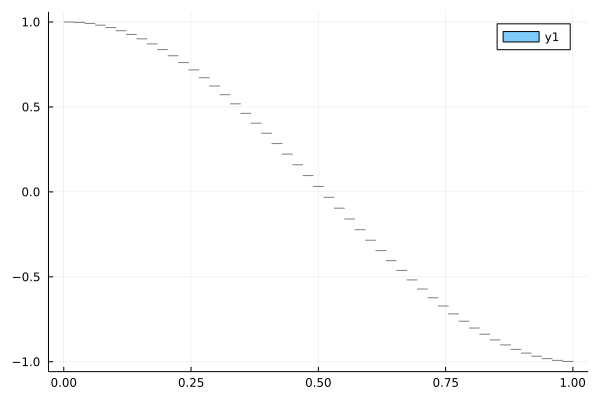

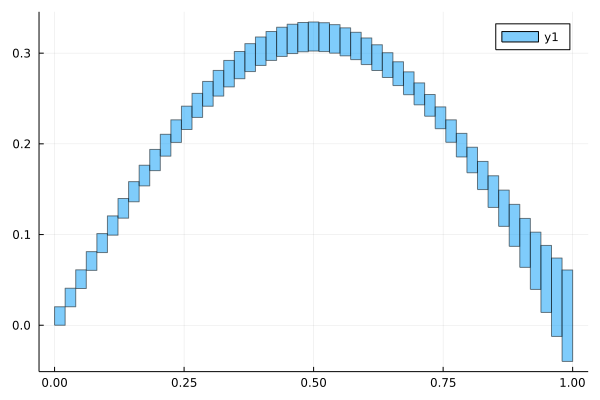

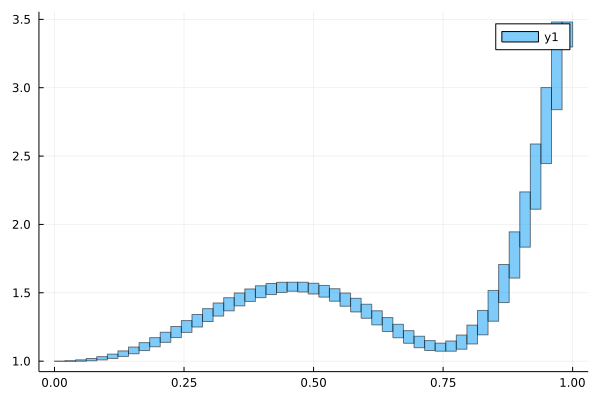

┌─────┬──────────┬───────────┐
│   p │       λ₁ │      λ₁ᵘᵖ │
├─────┼──────────┼───────────┤
│ 2.0 │ 9.869604 │ 56.825836 │
└─────┴──────────┴───────────┘
  0.110078 seconds (1.14 M allocations: 31.300 MiB, 4.32% compilation time)


In [26]:
@time begin
    n = 51 # number of division points
    ns = 1 # number of subdivision points of each subinterval
    
    λ₁ᵉˣᵃᶜᵗ(P) = (P-1)*(2*(π/P)/(sin(π/P)))^P

    λ₁ˡᵒʷs = Float64[]
    λ₁ˡᵒʷs_err = Float64[]

    λ₁ᵘᵖs = Float64[]
    λ₁ᵘᵖs_err = Float64[]

    si = mince(0..1,(n-1)*ns)

    #ps = 1.5:0.1:3.0
    ps = [2,]
    p=2
    #for p in ps
        λ₁ = λ₁ᵉˣᵃᶜᵗ(p)
        λᵢₙᵢₜ = (3.,1.5*λ₁)
        
        #r = 10/(n*ns)
        #dom = (-r, r+1)

        ### lower estimate
        #t, tᴵ, U₁, U₁ᴵ, U₂, U₂ᴵ, Λ₁ = plaplace_solve(λᵢₙᵢₜ, p, n, 
        #    dom=dom);
        #ud1 = -Λ₁ * U₁[end]^(p-1)
        #csc_V₂, V₂ = cubic_end_slope_spline(t, tᴵ, U₂, U₂ᴵ, 
        #    ud1, ud1, ns=ns);
        #V₁ = get_v1(p, V₂, t);
        #V₂_der = der_cubic_spline(csc_V₂, t, tᴵ, ns);
        #λ₁ˡᵒʷ, Fˡᵒʷ = lower_estimate(V₂_der, V₁, p)
        #append!(λ₁ˡᵒʷs, λ₁ˡᵒʷ)
        #append!(λ₁ˡᵒʷs_err, λ₁ˡᵒʷ-λ₁)

        ### upper estimate
        t, tᴵ, U₁, U₁ᴵ, U₂, U₂ᴵ, Ud, Udᴵ, Λ₁ = plaplace_solve(λᵢₙᵢₜ, p, n);
    
    
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
    boxes = IntervalBox.(x_int,U₂ᴵ[1:end-1]);
        display(plot(boxes))
    
    
        U₁[end] = 0
        U₁ᴵ[end] = 0..0
        #následující řádek nahradit novým výpočtem
        #csc_V₁, V₁ = cubic_natural_spline(t, tᴵ, U₁, U₁ᴵ, 0., 0., 
        #    ns=ns);
        csc_V₁, V₁ = polynomial_interpolation(t, tᴵ, U₁ᴵ, Udᴵ);
        inc = inf(minimum(V₁))
        #V₁ = V₁ .- inc
        #for i in length(csc_V₁)
        #    csc_V₁[i][4] = csc_V₁[i][4] - inc
        #end
            
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
        boxes = IntervalBox.(x_int,V₁);
        display(plot(boxes))
        
        V₁_der = der_cubic_spline(csc_V₁, t, tᴵ, ns); 
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
        boxes = IntervalBox.(x_int,V₁_der);
        display(plot(boxes))
    
    
    λ₁ᵘᵖ = upper_estimate(V₁, V₁_der, p);
        append!(λ₁ᵘᵖs, λ₁ᵘᵖ)
        append!(λ₁ᵘᵖs_err, λ₁ᵘᵖ-λ₁)
    pretty_table(hcat(ps, λ₁ᵉˣᵃᶜᵗ.(ps), ceil.(λ₁ᵘᵖs, digits=6)), header=["p","λ₁","λ₁ᵘᵖ"], formatters = ft_printf("%5.6f", 2:4))
    #end
    
end

**Experiment 2**
- výpočet pomocí splinu
- $p = 2$ 
- $n = 51$
- $ns = 1$

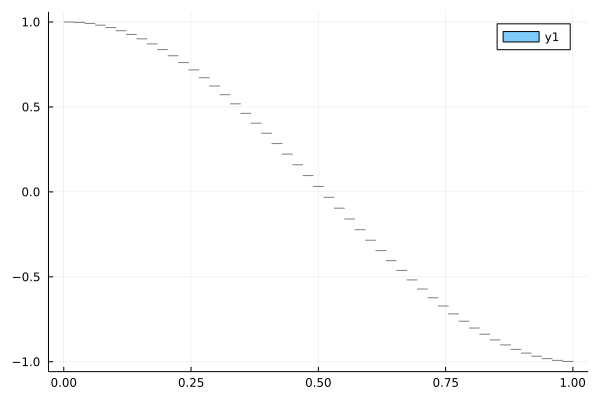

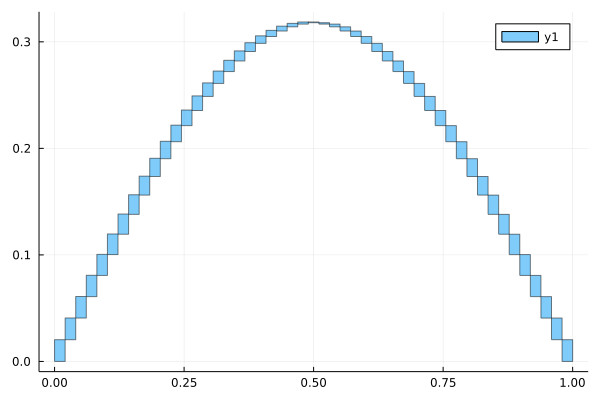

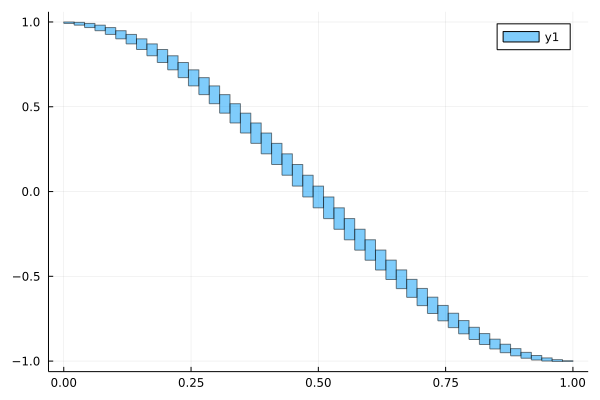

┌─────┬──────────┬───────────┐
│   p │       λ₁ │      λ₁ᵘᵖ │
├─────┼──────────┼───────────┤
│ 2.0 │ 9.869604 │ 11.152479 │
└─────┴──────────┴───────────┘
  0.160799 seconds (1.18 M allocations: 43.849 MiB, 4.24% compilation time)


In [16]:
@time begin
    n = 51 # number of division points
    ns = 1 # number of subdivision points of each subinterval
    
    λ₁ᵉˣᵃᶜᵗ(P) = (P-1)*(2*(π/P)/(sin(π/P)))^P

    λ₁ˡᵒʷs = Float64[]
    λ₁ˡᵒʷs_err = Float64[]

    λ₁ᵘᵖs = Float64[]
    λ₁ᵘᵖs_err = Float64[]

    si = mince(0..1,(n-1)*ns)

    #ps = 1.5:0.1:3.0
    ps = [2,]
    p=2
    #for p in ps
        λ₁ = λ₁ᵉˣᵃᶜᵗ(p)
        λᵢₙᵢₜ = (3.,1.5*λ₁)
        
        #r = 10/(n*ns)
        #dom = (-r, r+1)

        ### lower estimate
        #t, tᴵ, U₁, U₁ᴵ, U₂, U₂ᴵ, Λ₁ = plaplace_solve(λᵢₙᵢₜ, p, n, 
        #    dom=dom);
        #ud1 = -Λ₁ * U₁[end]^(p-1)
        #csc_V₂, V₂ = cubic_end_slope_spline(t, tᴵ, U₂, U₂ᴵ, 
        #    ud1, ud1, ns=ns);
        #V₁ = get_v1(p, V₂, t);
        #V₂_der = der_cubic_spline(csc_V₂, t, tᴵ, ns);
        #λ₁ˡᵒʷ, Fˡᵒʷ = lower_estimate(V₂_der, V₁, p)
        #append!(λ₁ˡᵒʷs, λ₁ˡᵒʷ)
        #append!(λ₁ˡᵒʷs_err, λ₁ˡᵒʷ-λ₁)

        ### upper estimate
        t, tᴵ, U₁, U₁ᴵ, U₂, U₂ᴵ, Ud, Udᴵ, Λ₁ = plaplace_solve(λᵢₙᵢₜ, p, n);
    
    
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
    boxes = IntervalBox.(x_int,U₂ᴵ[1:end-1]);
        display(plot(boxes))
    
    
        U₁[end] = 0
        U₁ᴵ[end] = 0..0

        csc_V₁, V₁ = cubic_natural_spline(t, tᴵ, U₁, U₁ᴵ, 0., 0., 
            ns=ns);
        #csc_V₁, V₁ = polynomial_interpolation(t, tᴵ, U₁ᴵ, Udᴵ);
        #inc = inf(minimum(V₁))
        #V₁ = V₁ .- inc
        #for i in length(csc_V₁)
        #    csc_V₁[i][4] = csc_V₁[i][4] - inc
        #end
            
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
        boxes = IntervalBox.(x_int,V₁);
        display(plot(boxes))
        
        V₁_der = der_cubic_spline(csc_V₁, t, tᴵ, ns); 
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
        boxes = IntervalBox.(x_int,V₁_der);
        display(plot(boxes))
    
    
    λ₁ᵘᵖ = upper_estimate(V₁, V₁_der, p);
        append!(λ₁ᵘᵖs, λ₁ᵘᵖ)
        append!(λ₁ᵘᵖs_err, λ₁ᵘᵖ-λ₁)
    pretty_table(hcat(ps, λ₁ᵉˣᵃᶜᵗ.(ps), ceil.(λ₁ᵘᵖs, digits=6)), header=["p","λ₁","λ₁ᵘᵖ"], formatters = ft_printf("%5.6f", 2:4))
    #end
    
end

**Experiment 3**
- výpočet bez splinu
- $p = 2$ 
- $n = 5001$
- $ns = 1$

In [13]:
@time begin
    n = 5001 # number of division points
    ns = 1 # number of subdivision points of each subinterval
    
    λ₁ᵉˣᵃᶜᵗ(P) = (P-1)*(2*(π/P)/(sin(π/P)))^P

    λ₁ˡᵒʷs = Float64[]
    λ₁ˡᵒʷs_err = Float64[]

    λ₁ᵘᵖs = Float64[]
    λ₁ᵘᵖs_err = Float64[]

    si = mince(0..1,(n-1)*ns)

    #ps = 1.5:0.1:3.0
    ps = [2,]
    p=2
    #for p in ps
        λ₁ = λ₁ᵉˣᵃᶜᵗ(p)
        λᵢₙᵢₜ = (3.,1.5*λ₁)
        
        #r = 10/(n*ns)
        #dom = (-r, r+1)

        ### lower estimate
        #t, tᴵ, U₁, U₁ᴵ, U₂, U₂ᴵ, Λ₁ = plaplace_solve(λᵢₙᵢₜ, p, n, 
        #    dom=dom);
        #ud1 = -Λ₁ * U₁[end]^(p-1)
        #csc_V₂, V₂ = cubic_end_slope_spline(t, tᴵ, U₂, U₂ᴵ, 
        #    ud1, ud1, ns=ns);
        #V₁ = get_v1(p, V₂, t);
        #V₂_der = der_cubic_spline(csc_V₂, t, tᴵ, ns);
        #λ₁ˡᵒʷ, Fˡᵒʷ = lower_estimate(V₂_der, V₁, p)
        #append!(λ₁ˡᵒʷs, λ₁ˡᵒʷ)
        #append!(λ₁ˡᵒʷs_err, λ₁ˡᵒʷ-λ₁)

        ### upper estimate
        t, tᴵ, U₁, U₁ᴵ, U₂, U₂ᴵ, Ud, Udᴵ, Λ₁ = plaplace_solve(λᵢₙᵢₜ, p, n);
    
    
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
    boxes = IntervalBox.(x_int,U₂ᴵ[1:end-1]);
        display(plot(boxes))
    
    
        U₁[end] = 0
        U₁ᴵ[end] = 0..0
        #následující řádek nahradit novým výpočtem
        #csc_V₁, V₁ = cubic_natural_spline(t, tᴵ, U₁, U₁ᴵ, 0., 0., 
        #    ns=ns);
        csc_V₁, V₁ = polynomial_interpolation(t, tᴵ, U₁ᴵ, Udᴵ);
        inc = inf(minimum(V₁))
        #V₁ = V₁ .- inc
        #for i in length(csc_V₁)
        #    csc_V₁[i][4] = csc_V₁[i][4] - inc
        #end
            
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
        boxes = IntervalBox.(x_int,V₁);
        display(plot(boxes))
        
        V₁_der = der_cubic_spline(csc_V₁, t, tᴵ, ns); 
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
        boxes = IntervalBox.(x_int,V₁_der);
        display(plot(boxes))
    
    
    λ₁ᵘᵖ = upper_estimate(V₁, V₁_der, p);
        append!(λ₁ᵘᵖs, λ₁ᵘᵖ)
        append!(λ₁ᵘᵖs_err, λ₁ᵘᵖ-λ₁)
    pretty_table(hcat(ps, λ₁ᵉˣᵃᶜᵗ.(ps), ceil.(λ₁ᵘᵖs, digits=6)), header=["p","λ₁","λ₁ᵘᵖ"], formatters = ft_printf("%5.6f", 2:4))
    #end
    
end

┌─────┬──────────┬───────────┐
│   p │       λ₁ │      λ₁ᵘᵖ │
├─────┼──────────┼───────────┤
│ 2.0 │ 9.869604 │ 45.877847 │
└─────┴──────────┴───────────┘
  2.765454 seconds (7.04 M allocations: 1.399 GiB, 15.64% gc time, 4.75% compilation time)


**Experiment 4**
- výpočet pomocí splinu
- $p = 2$ 
- $n = 5001$
- $ns = 1$

In [18]:
@time begin
    n = 5001 # number of division points
    ns = 1 # number of subdivision points of each subinterval
    
    λ₁ᵉˣᵃᶜᵗ(P) = (P-1)*(2*(π/P)/(sin(π/P)))^P

    λ₁ˡᵒʷs = Float64[]
    λ₁ˡᵒʷs_err = Float64[]

    λ₁ᵘᵖs = Float64[]
    λ₁ᵘᵖs_err = Float64[]

    si = mince(0..1,(n-1)*ns)

    #ps = 1.5:0.1:3.0
    ps = [2,]
    p=2
    #for p in ps
        λ₁ = λ₁ᵉˣᵃᶜᵗ(p)
        λᵢₙᵢₜ = (3.,1.5*λ₁)
        
        #r = 10/(n*ns)
        #dom = (-r, r+1)

        ### lower estimate
        #t, tᴵ, U₁, U₁ᴵ, U₂, U₂ᴵ, Λ₁ = plaplace_solve(λᵢₙᵢₜ, p, n, 
        #    dom=dom);
        #ud1 = -Λ₁ * U₁[end]^(p-1)
        #csc_V₂, V₂ = cubic_end_slope_spline(t, tᴵ, U₂, U₂ᴵ, 
        #    ud1, ud1, ns=ns);
        #V₁ = get_v1(p, V₂, t);
        #V₂_der = der_cubic_spline(csc_V₂, t, tᴵ, ns);
        #λ₁ˡᵒʷ, Fˡᵒʷ = lower_estimate(V₂_der, V₁, p)
        #append!(λ₁ˡᵒʷs, λ₁ˡᵒʷ)
        #append!(λ₁ˡᵒʷs_err, λ₁ˡᵒʷ-λ₁)

        ### upper estimate
        t, tᴵ, U₁, U₁ᴵ, U₂, U₂ᴵ, Ud, Udᴵ, Λ₁ = plaplace_solve(λᵢₙᵢₜ, p, n);
    
    
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
    boxes = IntervalBox.(x_int,U₂ᴵ[1:end-1]);
        display(plot(boxes))
    
    
        U₁[end] = 0
        U₁ᴵ[end] = 0..0

        csc_V₁, V₁ = cubic_natural_spline(t, tᴵ, U₁, U₁ᴵ, 0., 0., 
            ns=ns);
        #csc_V₁, V₁ = polynomial_interpolation(t, tᴵ, U₁ᴵ, Udᴵ);
        #inc = inf(minimum(V₁))
        #V₁ = V₁ .- inc
        #for i in length(csc_V₁)
        #    csc_V₁[i][4] = csc_V₁[i][4] - inc
        #end
            
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
        boxes = IntervalBox.(x_int,V₁);
        display(plot(boxes))
        
        V₁_der = der_cubic_spline(csc_V₁, t, tᴵ, ns); 
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
        boxes = IntervalBox.(x_int,V₁_der);
        display(plot(boxes))
    
    
    λ₁ᵘᵖ = upper_estimate(V₁, V₁_der, p);
        append!(λ₁ᵘᵖs, λ₁ᵘᵖ)
        append!(λ₁ᵘᵖs_err, λ₁ᵘᵖ-λ₁)
    pretty_table(hcat(ps, λ₁ᵉˣᵃᶜᵗ.(ps), ceil.(λ₁ᵘᵖs, digits=6)), header=["p","λ₁","λ₁ᵘᵖ"], formatters = ft_printf("%5.6f", 2:4))
    #end
    
end

┌─────┬──────────┬──────────┐
│   p │       λ₁ │     λ₁ᵘᵖ │
├─────┼──────────┼──────────┤
│ 2.0 │ 9.869604 │ 9.881457 │
└─────┴──────────┴──────────┘
1851.037820 seconds (82.01 M allocations: 5.127 GiB, 0.09% gc time, 0.00% compilation time)


**Experiment 5**
- výpočet pomocí splinu
- $p = 2$ 
- $n = 501$
- $ns = 10$

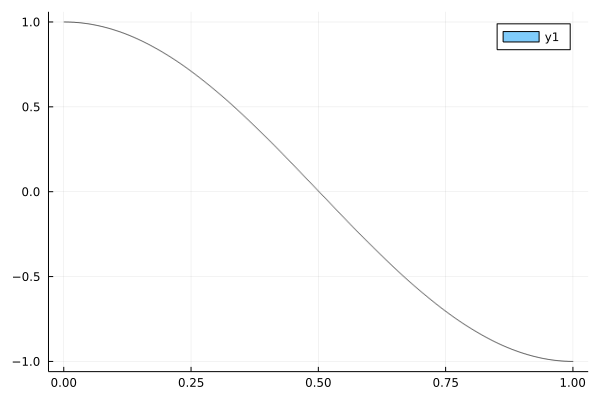

┌─────┬──────────┬──────────┐
│   p │       λ₁ │     λ₁ᵘᵖ │
├─────┼──────────┼──────────┤
│ 2.0 │ 9.869604 │ 9.881497 │
└─────┴──────────┴──────────┘
  2.510860 seconds (3.67 M allocations: 260.546 MiB, 3.36% gc time, 0.20% compilation time)


In [21]:
@time begin
    n = 501 # number of division points
    ns = 10 # number of subdivision points of each subinterval
    
    λ₁ᵉˣᵃᶜᵗ(P) = (P-1)*(2*(π/P)/(sin(π/P)))^P

    λ₁ˡᵒʷs = Float64[]
    λ₁ˡᵒʷs_err = Float64[]

    λ₁ᵘᵖs = Float64[]
    λ₁ᵘᵖs_err = Float64[]

    si = mince(0..1,(n-1)*ns)

    #ps = 1.5:0.1:3.0
    ps = [2,]
    p=2
    #for p in ps
        λ₁ = λ₁ᵉˣᵃᶜᵗ(p)
        λᵢₙᵢₜ = (3.,1.5*λ₁)
        
        #r = 10/(n*ns)
        #dom = (-r, r+1)

        ### lower estimate
        #t, tᴵ, U₁, U₁ᴵ, U₂, U₂ᴵ, Λ₁ = plaplace_solve(λᵢₙᵢₜ, p, n, 
        #    dom=dom);
        #ud1 = -Λ₁ * U₁[end]^(p-1)
        #csc_V₂, V₂ = cubic_end_slope_spline(t, tᴵ, U₂, U₂ᴵ, 
        #    ud1, ud1, ns=ns);
        #V₁ = get_v1(p, V₂, t);
        #V₂_der = der_cubic_spline(csc_V₂, t, tᴵ, ns);
        #λ₁ˡᵒʷ, Fˡᵒʷ = lower_estimate(V₂_der, V₁, p)
        #append!(λ₁ˡᵒʷs, λ₁ˡᵒʷ)
        #append!(λ₁ˡᵒʷs_err, λ₁ˡᵒʷ-λ₁)

        ### upper estimate
        t, tᴵ, U₁, U₁ᴵ, U₂, U₂ᴵ, Ud, Udᴵ, Λ₁ = plaplace_solve(λᵢₙᵢₜ, p, n);
    
    
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,n-2);
        boxes = IntervalBox.(x_int,U₂ᴵ[1:end-1]);
        display(plot(boxes))
    
    
        U₁[end] = 0
        U₁ᴵ[end] = 0..0

        csc_V₁, V₁ = cubic_natural_spline(t, tᴵ, U₁, U₁ᴵ, 0., 0., 
            ns=ns);
        #csc_V₁, V₁ = polynomial_interpolation(t, tᴵ, U₁ᴵ, Udᴵ);
        #inc = inf(minimum(V₁))
        #V₁ = V₁ .- inc
        #for i in length(csc_V₁)
        #    csc_V₁[i][4] = csc_V₁[i][4] - inc
        #end
            
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,(n*ns)-2*ns);
        boxes = IntervalBox.(x_int,V₁);
        display(plot(boxes))
        
        V₁_der = der_cubic_spline(csc_V₁, t, tᴵ, ns); 
        x_dom = t[1]..t[end];
        x_int = mince(x_dom,(n*ns)-2*ns);
        boxes = IntervalBox.(x_int,V₁_der);
        display(plot(boxes))
    
    
    λ₁ᵘᵖ = upper_estimate(V₁, V₁_der, p);
        append!(λ₁ᵘᵖs, λ₁ᵘᵖ)
        append!(λ₁ᵘᵖs_err, λ₁ᵘᵖ-λ₁)
    pretty_table(hcat(ps, λ₁ᵉˣᵃᶜᵗ.(ps), ceil.(λ₁ᵘᵖs, digits=6)), header=["p","λ₁","λ₁ᵘᵖ"], formatters = ft_printf("%5.6f", 2:4))
    #end
    
end